In this notebook, we'll walk through the steps required to train your own DCGAN on the bricks dataset

In [ ]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    callbacks,
    losses,
    utils,
    metrics,
    optimizers,
)

from utils import display, sample_batch

## 0. Parameters <a name="parameters"></a>

In [ ]:
IMAGE_SIZE = 64
CHANNELS = 3
BATCH_SIZE = 128
Z_DIM = 100
EPOCHS = 300
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999
LEARNING_RATE = 0.0002
NOISE_PARAM = 0.1

## 1. Prepare the data <a name="prepare"></a>

In [ ]:
import os
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.models import save_model
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import vgg16
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import preprocess_input
from xml.etree import ElementTree as ET
from sklearn.metrics import average_precision_score, accuracy_score, precision_recall_curve, auc
import gc
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
from tensorflow.keras.utils import Sequence
from tqdm import tqdm
import pandas as pd
from IPython.display import Image, display
import seaborn as sns

import os
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from PIL import Image
import tensorflow as tf

In [ ]:
os.makedirs("/content/models")
print("Folder created successfully.")

Folder created successfully.


In [ ]:
ANNOTATION_DIR ='VOCdevkit/VOC2008/Annotations'
LABELS_DIR     = 'VOCdevkit/VOC2008/ImageSets/Main'
TRAIN_DIR = 'VOCdevkit/VOC2008/ImageSets/Main/train.txt'
VAL_DIR ='VOCdevkit/VOC2008/ImageSets/Main/val.txt'
IMAGES_DIR = 'VOCdevkit/VOC2008/JPEGImages'
OUTPUT_DIR='dataset.csv'

tf.keras.utils.set_random_seed(42)

!wget http://host.robots.ox.ac.uk/pascal/VOC/voc2008/VOCtrainval_14-Jul-2008.tar
!tar -xf VOCtrainval_14-Jul-2008.tar

--2024-04-21 15:20:20--  http://host.robots.ox.ac.uk/pascal/VOC/voc2008/VOCtrainval_14-Jul-2008.tar
Resolving host.robots.ox.ac.uk (host.robots.ox.ac.uk)... 129.67.94.152
Connecting to host.robots.ox.ac.uk (host.robots.ox.ac.uk)|129.67.94.152|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 577034240 (550M) [application/x-tar]
Saving to: ‘VOCtrainval_14-Jul-2008.tar’

VOCtrainval_14-Jul- 100%[===================>] 550.30M  15.7MB/s    in 38s     

2024-04-21 15:20:59 (14.5 MB/s) - ‘VOCtrainval_14-Jul-2008.tar’ saved [577034240/577034240]



In [ ]:
def get_unique_labels(labels_dir):
    labels = os.listdir(labels_dir)
    labels = sorted(list(set([label.split('_')[0] for label in labels if len(label.split('_')) > 1])))
    return labels

def read_file_list(file_path):
    with open(file_path, "r") as f:
        files = [line.strip() for line in f.readlines()]
    return files

def extract_labels_from_xml(file_names, annotation_dir):
    targets = []
    for file in tqdm(file_names, desc="Extracting labels"):
        file_path = os.path.join(annotation_dir, file + ".xml")
        labels = [box.find('name').text for box in ET.parse(file_path).getroot().iter('object')]
        targets.append(labels)
    return targets

def create_dataframe(train_files, val_files, train_targets, val_targets):
    df_train = pd.DataFrame({'id': train_files, 'set': 'train', 'target': train_targets})
    df_val = pd.DataFrame({'id': val_files, 'set': 'val', 'target': val_targets})
    df = pd.concat([df_train, df_val], ignore_index=True)
    df['id'] = df['id'] + '.jpg'
    return df

def save_dataframe_to_csv(df, output_dir):
    df.to_csv(output_dir, index=False)

def read_dataframe_from_csv(input_dir):
    df = pd.read_csv(input_dir)
    df['target'] = df['target'].apply(eval)
    return df

In [58]:
# Read training and validation set files
train_files = read_file_list(TRAIN_DIR)
val_files = read_file_list(VAL_DIR)
print("Training Size: ", len(train_files))
print("Validation Size: ", len(val_files))
print("\n\n\n")

train_targets = extract_labels_from_xml(train_files, ANNOTATION_DIR)
val_targets = extract_labels_from_xml(val_files, ANNOTATION_DIR)

df = create_dataframe(train_files, val_files, train_targets, val_targets) # dataframe (id, train/test set, target)
save_dataframe_to_csv(df, OUTPUT_DIR)
df = read_dataframe_from_csv(OUTPUT_DIR)

print("\n\n\n")
# Display unique labels and DataFrame
labels = get_unique_labels(LABELS_DIR)
print("The labels are", labels)
print("\n\n\n")
print(type(df))
df

Training Size:  2111
Validation Size:  2221






Extracting labels: 100%|██████████| 2221/2221 [00:00<00:00, 14832.19it/s]






The labels are ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']




<class 'pandas.core.frame.DataFrame'>


,id,set,target
0,2008_000008.jpg,train,"[horse, person]"
1,2008_000015.jpg,train,"[bottle, bottle]"
2,2008_000019.jpg,train,"[dog, dog, dog]"
3,2008_000023.jpg,train,"[tvmonitor, bottle, person, person, person]"
4,2008_000028.jpg,train,"[car, car]"
...,...,...,...
4327,2008_008755.jpg,val,"[person, person, bicycle]"
4328,2008_008758.jpg,val,"[bicycle, person]"
4329,2008_008765.jpg,val,[aeroplane]
4330,2008_008767.jpg,val,[train]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Function to load images
def load_images(image_paths):
    images = []
    for image_path in image_paths:
        try:
            image = Image.open(image_path)
            image = image.resize((64, 64))  # Resize images to fit VAE input size
            image = np.array(image) / 255.0  # Normalize pixel values
            images.append(image)
        except Exception as e:
            print(f"Error loading image '{image_path}': {e}")
    return np.array(images)

In [ ]:

def create_training_samples(class_name, image_folder):
    # Read filenames from train.txt
    train_filenames = []
    with open(os.path.join(image_folder, "ImageSets", "Main", f"{class_name}_train.txt"), 'r') as file:
        train_filenames += file.read().splitlines()


    # Combine filenames from all lists and remove duplicates
    all_filenames = list(set(train_filenames))

    print("Filenames from text files:")
    print(all_filenames)

    # Construct image paths and filter out missing files
    image_paths = []
    for filename in all_filenames:
        # Extract the label
        label = filename.strip().split()[1]  # Get the label part of the filename
        if label == '-1':
            continue  # Skip this image if the label is '-1'

        # Remove leading/trailing spaces and the "-1" suffix
        filename = filename.strip().split()[0]  # Split by space and take the first part
        image_path = os.path.join(image_folder, "JPEGImages", filename + '.jpg')  # Append '.jpg' after filename
        if os.path.exists(image_path):
            image_paths.append(image_path)
        else:
            print(f"File not found: {image_path}. Skipping...")
    if not image_paths:
        print(f"No images found for class: {class_name}. Skipping training...")
    else:
        # Load images
        images = load_images(image_paths)
        return images


## 2. Build the GAN <a name="build"></a>

In [46]:
discriminator_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same", use_bias=False)(
    discriminator_input
)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(
    128, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(
    256, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(
    512, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(
    1,
    kernel_size=4,
    strides=1,
    padding="valid",
    use_bias=False,
    activation="sigmoid",
)(x)
discriminator_output = layers.Flatten()(x)

discriminator = models.Model(discriminator_input, discriminator_output)
discriminator.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3072      
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 dropout_11 (Dropout)        (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131072    
                                                                 
 batch_normalization_7 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                           

In [47]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(
    512, kernel_size=4, strides=1, padding="valid", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    256, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    128, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    64, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(
    CHANNELS,
    kernel_size=4,
    strides=2,
    padding="same",
    use_bias=False,
    activation="tanh",
)(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 100)]             0         
                                                                 
 reshape_1 (Reshape)         (None, 1, 1, 100)         0         
                                                                 
 conv2d_transpose_5 (Conv2D  (None, 4, 4, 512)         819200    
 Transpose)                                                      
                                                                 
 batch_normalization_10 (Ba  (None, 4, 4, 512)         2048      
 tchNormalization)                                               
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2D  (None, 8, 8, 256)         209

In [48]:
class DCGAN(models.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim

    def compile(self, d_optimizer, g_optimizer):
        super(DCGAN, self).compile()
        self.loss_fn = losses.BinaryCrossentropy()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_metric = metrics.Mean(name="d_loss")
        self.d_real_acc_metric = metrics.BinaryAccuracy(name="d_real_acc")
        self.d_fake_acc_metric = metrics.BinaryAccuracy(name="d_fake_acc")
        self.d_acc_metric = metrics.BinaryAccuracy(name="d_acc")
        self.g_loss_metric = metrics.Mean(name="g_loss")
        self.g_acc_metric = metrics.BinaryAccuracy(name="g_acc")

    @property
    def metrics(self):
        return [
            self.d_loss_metric,
            self.d_real_acc_metric,
            self.d_fake_acc_metric,
            self.d_acc_metric,
            self.g_loss_metric,
            self.g_acc_metric,
        ]

    def train_step(self, real_images):
        # Sample random points in the latent space
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(
            shape=(batch_size, self.latent_dim)
        )

        # Train the discriminator on fake images
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            generated_images = self.generator(
                random_latent_vectors, training=True
            )
            real_predictions = self.discriminator(real_images, training=True)
            fake_predictions = self.discriminator(
                generated_images, training=True
            )

            real_labels = tf.ones_like(real_predictions)
            real_noisy_labels = real_labels + NOISE_PARAM * tf.random.uniform(
                tf.shape(real_predictions)
            )
            fake_labels = tf.zeros_like(fake_predictions)
            fake_noisy_labels = fake_labels - NOISE_PARAM * tf.random.uniform(
                tf.shape(fake_predictions)
            )

            d_real_loss = self.loss_fn(real_noisy_labels, real_predictions)
            d_fake_loss = self.loss_fn(fake_noisy_labels, fake_predictions)
            d_loss = (d_real_loss + d_fake_loss) / 2.0

            g_loss = self.loss_fn(real_labels, fake_predictions)

        gradients_of_discriminator = disc_tape.gradient(
            d_loss, self.discriminator.trainable_variables
        )
        gradients_of_generator = gen_tape.gradient(
            g_loss, self.generator.trainable_variables
        )

        self.d_optimizer.apply_gradients(
            zip(gradients_of_discriminator, discriminator.trainable_variables)
        )
        self.g_optimizer.apply_gradients(
            zip(gradients_of_generator, generator.trainable_variables)
        )

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.d_real_acc_metric.update_state(real_labels, real_predictions)
        self.d_fake_acc_metric.update_state(fake_labels, fake_predictions)
        self.d_acc_metric.update_state(
            [real_labels, fake_labels], [real_predictions, fake_predictions]
        )
        self.g_loss_metric.update_state(g_loss)
        self.g_acc_metric.update_state(real_labels, fake_predictions)

        return {m.name: m.result() for m in self.metrics}

In [50]:
import os
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from PIL import Image
import tensorflow as tf



In [51]:


import matplotlib.pyplot as plt
import os


def ImageGeneration_and_save(model,num_img, latent_dim):
  random_latent_vectors = tf.random.normal(
      shape=(num_img, latent_dim)
  )
  generated_images = model.predict(random_latent_vectors)
  generated_images = generated_images * 127.5 + 127.5
  return generated_images
  # Create output directory if it doesn't exist
  os.makedirs(output_dir, exist_ok=True)



# Training GAN for each class

In [56]:



dataset_folder = r"/content/VOCdevkit/VOC2008"

models_directory = "/content/drive/MyDrive/GenAI_Project_A/GAN_models"  # Specify the directory to save models

# # Create the directory if it doesn't exist
os.makedirs(models_directory, exist_ok=True)

gan_models = {}


for class_name in labels:
    print(f"Training GAN for class: {class_name}")

    dcgan = DCGAN(

        discriminator=discriminator, generator=generator, latent_dim=Z_DIM
    )

    dcgan.compile(
    d_optimizer=optimizers.Adam(
            learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
        ),
        g_optimizer=optimizers.Adam(
            learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
        ),
    )

    # Load and preprocess training data for the current class
    X_train = create_training_samples(class_name, dataset_folder)

    # Train the GAN model for the current class
    if X_train is not None:
        dcgan.fit(X_train, epochs=2500, batch_size=8)
        gan_models[class_name] = dcgan
        # Save the model
        model_filename = os.path.join(models_directory, f"{class_name}_gan_model")
        dcgan.save_model(model_filename)


In [ ]:
import os
import tensorflow as tf

# Directory containing the saved models
directory = '/content/drive/MyDrive/GenAI_Project_A/GAN_models'

# List all directories (presumably each represents a saved model)
model_dirs = [d for d in os.listdir(directory) if os.path.isdir(os.path.join(directory, d))]
i=0
# Load each model and assign names
loaded_models = {}
for model_dir in model_dirs:
    if "generator" in model_dir:
      print(i)
      i+=1
      model_path = os.path.join(directory, model_dir)
      print(model_path)

      # Extract name from the model directory name
      model_name = model_dir.split('_')[0]  # Assuming the name is before the first underscore

      # Load the model
      loaded_model = tf.keras.models.load_model(model_path)

      d_optimizer = optimizers.Adam(
          learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
      )
      g_optimizer = optimizers.Adam(
          learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
      )


      loaded_model.d_optimizer = d_optimizer
      loaded_model.g_optimizer = g_optimizer

      loaded_model.compile(optimizer=[d_optimizer, g_optimizer], loss='your_loss_function', metrics=['accuracy'])


      loaded_models[model_name] = loaded_model









0
/content/drive/MyDrive/GenAI_Project_A/GAN_models/diningtable_gan_model_generator


1
/content/drive/MyDrive/GenAI_Project_A/GAN_models/dog_gan_model_generator


2
/content/drive/MyDrive/GenAI_Project_A/GAN_models/horse_gan_model_generator


3
/content/drive/MyDrive/GenAI_Project_A/GAN_models/motorbike_gan_model_generator


4
/content/drive/MyDrive/GenAI_Project_A/GAN_models/bus_gan_model_generator


5
/content/drive/MyDrive/GenAI_Project_A/GAN_models/aeroplane_gan_model_generator


6
/content/drive/MyDrive/GenAI_Project_A/GAN_models/bicycle_gan_model_generator


7
/content/drive/MyDrive/GenAI_Project_A/GAN_models/car_gan_model_generator


8
/content/drive/MyDrive/GenAI_Project_A/GAN_models/bird_gan_model_generator


9
/content/drive/MyDrive/GenAI_Project_A/GAN_models/cat_gan_model_generator


10
/content/drive/MyDrive/GenAI_Project_A/GAN_models/boat_gan_model_generator


11
/content/drive/MyDrive/GenAI_Project_A/GAN_models/pottedplant_gan_model_generator


12
/content/drive/MyDrive/GenAI_Project_A/GAN_models/person_gan_model_generator


13
/content/drive/MyDrive/GenAI_Project_A/GAN_models/sheep_gan_model_generator


14
/content/drive/MyDrive/GenAI_Project_A/GAN_models/chair_gan_model_generator


15
/content/drive/MyDrive/GenAI_Project_A/GAN_models/bottle_gan_model_generator


16
/content/drive/MyDrive/GenAI_Project_A/GAN_models/cow_gan_model_generator


17
/content/drive/MyDrive/GenAI_Project_A/GAN_models/sofa_gan_model_generator


18
/content/drive/MyDrive/GenAI_Project_A/GAN_models/train_gan_model_generator


19
/content/drive/MyDrive/GenAI_Project_A/GAN_models/tvmonitor_gan_model_generator


In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model


# Function to generate images from random latent vectors
def generate_images(gan, num_samples=25):
    grid_width, grid_height = (10, 3)
    z_sample = np.random.normal(size=(grid_width * grid_height, Z_DIM))

    generated_images=ImageGeneration_and_save(gan,num_img=num_samples, latent_dim=Z_DIM)
    return generated_images

# Function to display generated images
def display_generated_images(generated_images):
    num_samples = len(generated_images)
    print(num_samples)
    plt.figure(figsize=(12, 12))
    for i in range(num_samples):
        plt.subplot(5, 5, i+1)
        plt.imshow(generated_images[i].astype('uint8'))
        plt.title(i)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


# Generate and display images using the trained VAE model
num_samples = 25 # Number of images to generate



In [ ]:
# To display
# for class_name, gan_model in loaded_models.items():
#     print(f"Generating and displaying images for class: {class_name}")
#     generated_images = generate_images(gan_model, num_samples=num_samples)
#     display_generated_images(generated_images)

# Generating and saving images

In [60]:
import numpy as np
from PIL import Image

# Define the target width and height
target_width = 486
target_height = 500

# Assuming you have a base directory where you want to save the images
gen_base_dir = "/content/VOCdevkit/VOC2008/JPEGImages"
print(df.columns.tolist())
for class_name, gan_models in loaded_models.items():
    print(f"Generating and saving images for class: {class_name}")
    generated_images = generate_images(gan_models, num_samples=num_samples)



    # Save each generated image to the respective class folder
    for i, image in enumerate(generated_images):
        image_filename = os.path.join(gen_base_dir, f"{class_name}_{i}.jpg")

        # Convert the image array to uint8
        image = (image * 255).astype(np.uint8)
        image_pil = Image.fromarray(image)

        # Resize the image
        resized_image = image_pil.resize((target_width, target_height))

        # Save the resized image
        resized_image.save(image_filename)
        new_row = [ f"{class_name}_{i}.jpg", 'train', [class_name]]
        new_row_dict = {'id': new_row[0], 'set': new_row[1], 'target': new_row[2]}


        print(type(df.columns.tolist()))
        print(new_row_dict)
        df.loc[len(df)] = new_row_dict


    print(f"Images saved for class: {class_name}")

['id', 'set', 'target', 'sheep']
Generating and saving images for class: diningtable
1/1 [==============================] - 0s 18ms/step
<class 'list'>
{'id': 'diningtable_0.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_1.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_2.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_3.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_4.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_5.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_6.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_7.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_8.jpg', 'set': 'train', 'target': ['diningtable']}
<class 'list'>
{'id': 'diningtable_9.jpg', 'set': 'train', 'target': ['diningtable']}
<cl

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import Iterator


def create_data_generators(df, label, batch_size=32):
    target_size = (64, 64)

    df[label] = df['target'].apply(lambda x: 1 if label in x else 0)



    # Image data generator for original images
    datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )

    train_generator = datagen.flow_from_dataframe(
        dataframe=df[df['set'] == 'train'],  # Corrected placement of 'dataframe'
        directory=IMAGES_DIR,
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',  # Corrected class_mode
        shuffle=True
    )


    validation_generator = datagen.flow_from_dataframe(
        dataframe=df[df['set'] == 'val'],  # Corrected placement of 'dataframe'
        directory=IMAGES_DIR,
        x_col='id',
        y_col=label,
        batch_size=batch_size,
        target_size=target_size,
        class_mode='raw',  # Corrected class_mode
        shuffle=False
    )






    return train_generator, validation_generator


In [ ]:
for label in labels:
  train_generator, validation_generator = create_data_generators(df, label, batch_size=32)

  # Size of training generator
  train_generator_size = len(train_generator) * train_generator.batch_size

  # Size of validation generator
  validation_generator_size = len(validation_generator) * validation_generator.batch_size

  print("Size of training generator:", train_generator_size)
  print("Size of validation generator:", validation_generator_size)


Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generator: 2240
Found 2611 validated image filenames.
Found 2221 validated image filenames.
Size of training generator: 2624
Size of validation generato

  # VGG model

In [ ]:
class BinaryModel(tf.keras.Model):
    def __init__(self, label, folder_path=None):
        super().__init__()

        self.label = label
        input_shape = (64, 64, 3)

        if folder_path:
            model_path = os.path.join(folder_path, label + '.keras')
            if os.path.isfile(model_path):
                self._model = load_model(model_path)
                print('loaded', model_path)
        else:
            base_model = VGG16(weights='imagenet', include_top=False, input_shape=(64, 64, 3))
            for layer in base_model.layers:
                layer.trainable = False
            x = base_model.output
            x = layers.GlobalAveragePooling2D()(x)
            x = layers.Dense(128, activation='relu')(x)
            x = layers.Dropout(0.5)(x)
            predictions = layers.Dense(1, activation='sigmoid')(x)

            # Create the model
            self._model = Model(inputs=base_model.input, outputs=predictions)
            self.build(input_shape=(None, *input_shape))

    def call(self, inputs):
        return self._model(inputs)

    def summary(self):
        return self._model.summary()

    def save(self, folder_path):
        self._model.save(os.path.join(folder_path, self.label + '.keras'))

In [ ]:
def AP(y_true, y_pred):
    return tf.py_function(average_precision_score, [y_true, y_pred], tf.float32)

def train_model_for_label(label, df, already_done_labels, FOLDER_PATH, EPOCHS=50, BATCH_SIZE=25, OPTIMIZER='Adam', LOSS='binary_crossentropy', PATIENCE=5, MIN_DELTA=0.02, TARGET_SIZE=(224, 224, 3)):
    if label in already_done_labels:
        print("Skipping ", label, "- Model already trained.")
        return

    early_stopping = EarlyStopping(
        monitor='val_AP',
        min_delta=MIN_DELTA,
        patience=PATIENCE,
        verbose=1,
        mode='max',
        restore_best_weights=True,
        start_from_epoch=2
    )

    model = BinaryModel(label)

    model.compile(
        optimizer=OPTIMIZER,
        loss=LOSS,
        metrics=[AP],
    )


    train_gen, val_gen = create_data_generators(df, label,batch_size=32)


    model.fit(
        train_gen,
        epochs=EPOCHS,
        validation_data=val_gen,
        callbacks=[early_stopping]
    )

    model.save(FOLDER_PATH)

# Training VGG model for each class


In [59]:
FOLDER_PATH='/content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models'
os.makedirs(FOLDER_PATH, exist_ok=True)
already_done_labels = [item.removesuffix('.keras') for item in os.listdir(FOLDER_PATH)]
j=1
for label in labels:
  print(j)
  j+=1
  print(f"Training The Model for label {label}")
  train_model_for_label(label, df, already_done_labels, FOLDER_PATH)
  print("\n\n")

1
Training The Model for label aeroplane
Skipping  aeroplane - Model already trained.



2
Training The Model for label bicycle
Skipping  bicycle - Model already trained.



3
Training The Model for label bird
Skipping  bird - Model already trained.



4
Training The Model for label boat
Skipping  boat - Model already trained.



5
Training The Model for label bottle
Skipping  bottle - Model already trained.



6
Training The Model for label bus
Skipping  bus - Model already trained.



7
Training The Model for label car
Skipping  car - Model already trained.



8
Training The Model for label cat
Skipping  cat - Model already trained.



9
Training The Model for label chair
Skipping  chair - Model already trained.



10
Training The Model for label cow
Skipping  cow - Model already trained.



11
Training The Model for label diningtable
Skipping  diningtable - Model already trained.



12
Training The Model for label dog
Skipping  dog - Model already trained.



13
Training The Model f

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/aeroplane.keras
aeroplane
70/70 [==============================] - 7s 98ms/step


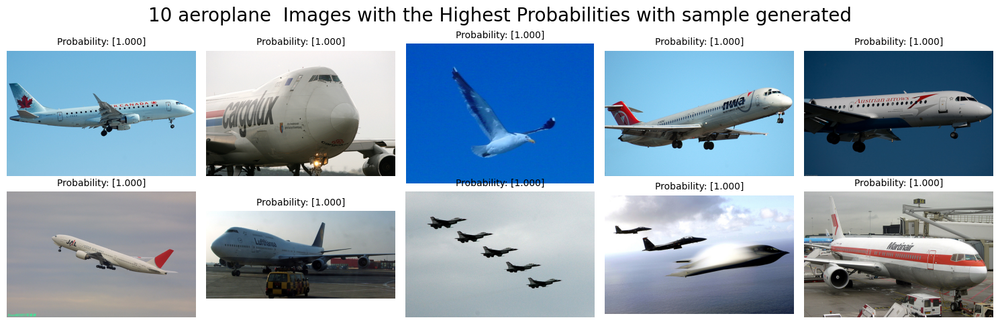

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/bicycle.keras
bicycle
70/70 [==============================] - 7s 105ms/step


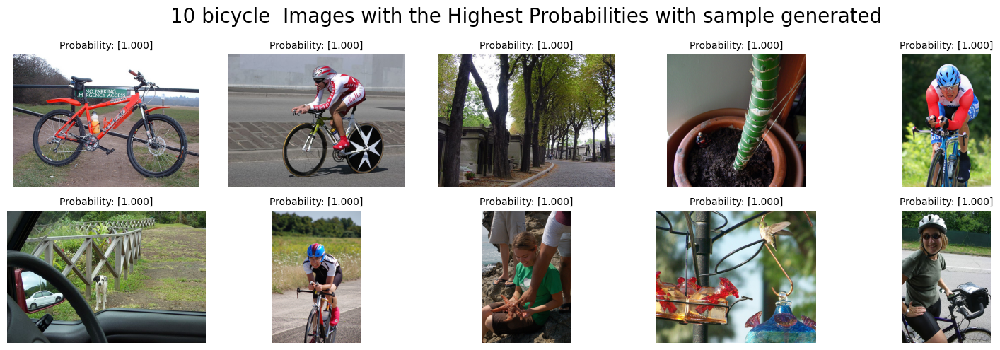

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/bird.keras
bird
70/70 [==============================] - 7s 92ms/step


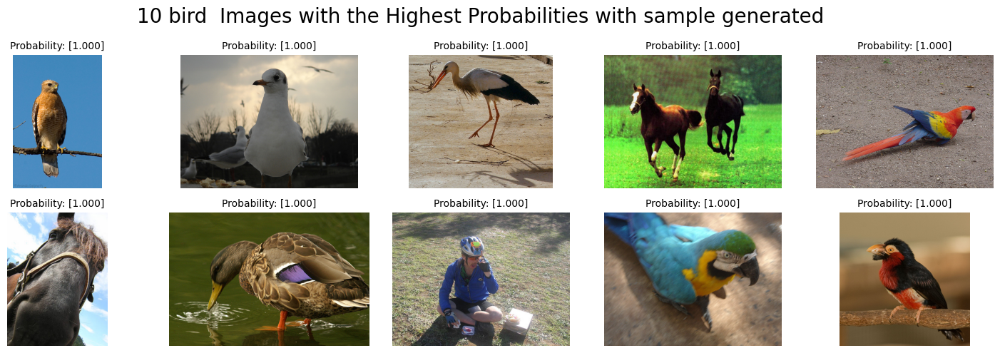

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/boat.keras
boat
70/70 [==============================] - 8s 116ms/step


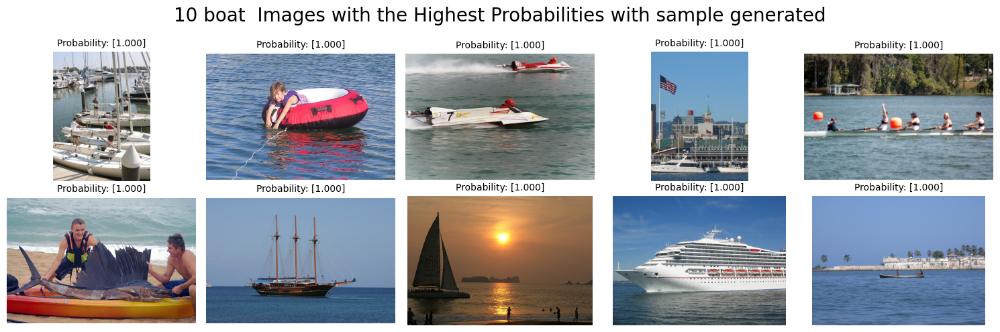

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/bottle.keras
bottle
70/70 [==============================] - 8s 108ms/step


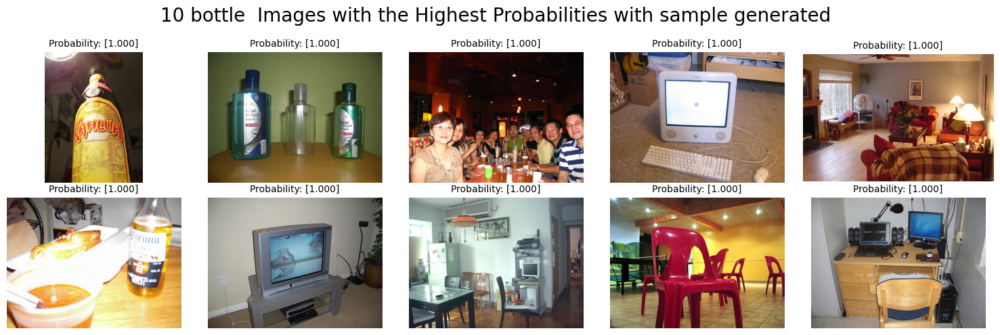

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/tvmonitor.keras
tvmonitor
70/70 [==============================] - 8s 108ms/step


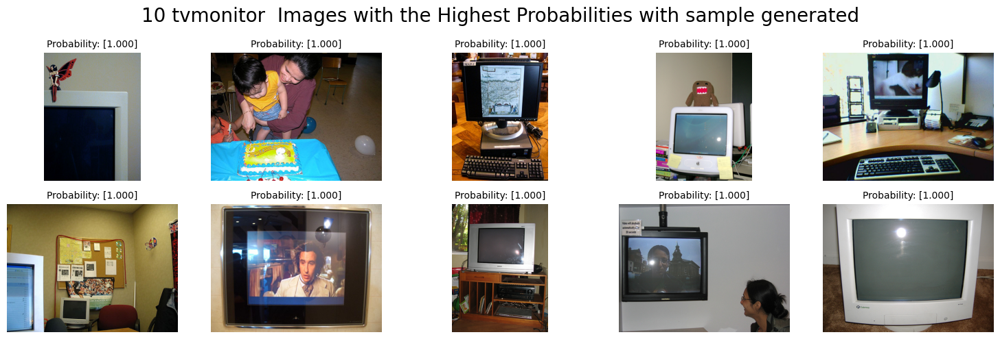

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/train.keras
train
70/70 [==============================] - 8s 114ms/step


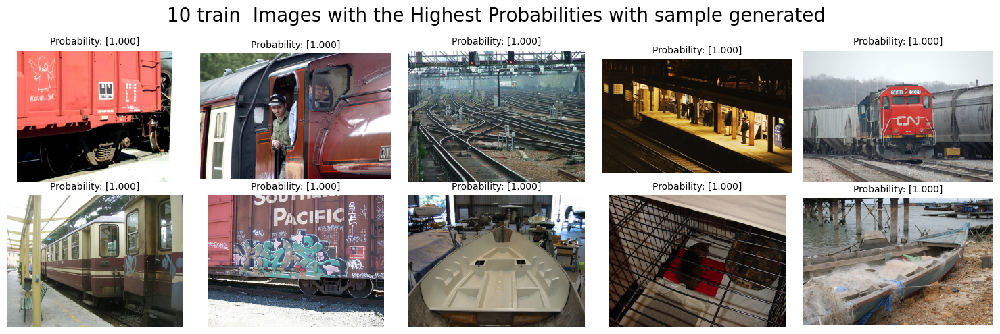

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/diningtable.keras
diningtable
70/70 [==============================] - 10s 140ms/step


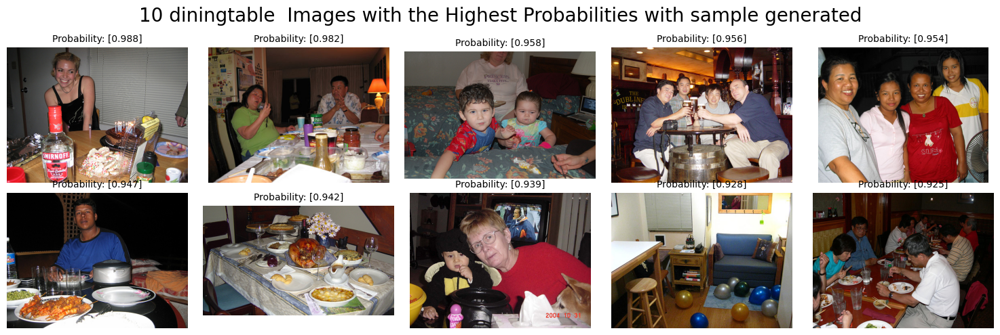

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/bus.keras
bus
70/70 [==============================] - 10s 138ms/step


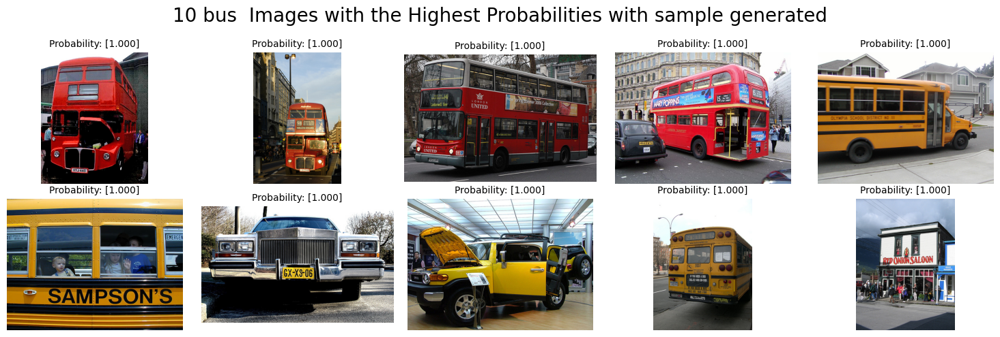

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/car.keras
car
70/70 [==============================] - 9s 131ms/step


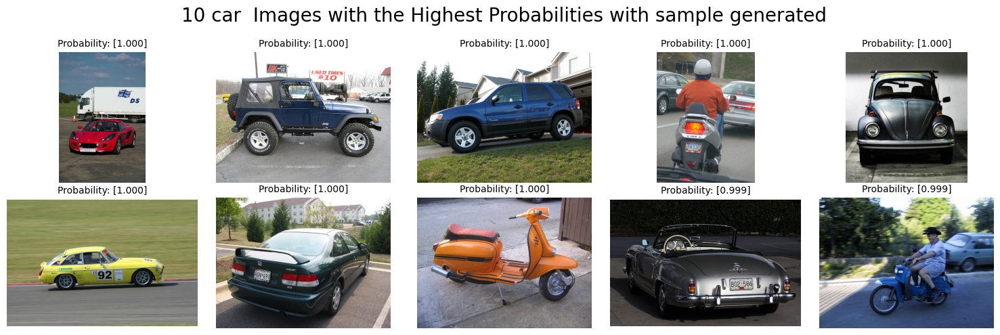

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/cat.keras
cat
70/70 [==============================] - 9s 133ms/step


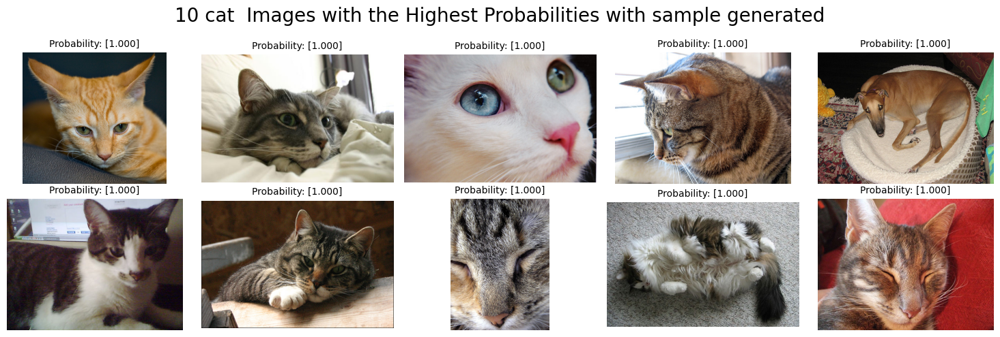

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/sofa.keras
sofa
70/70 [==============================] - 10s 137ms/step


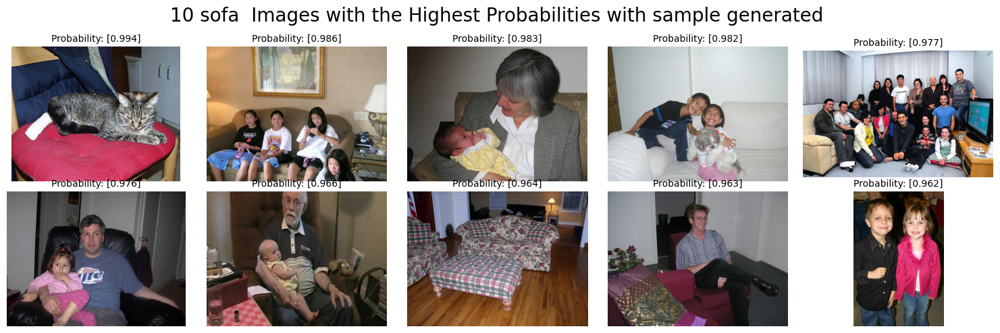

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/chair.keras
chair
70/70 [==============================] - 10s 142ms/step


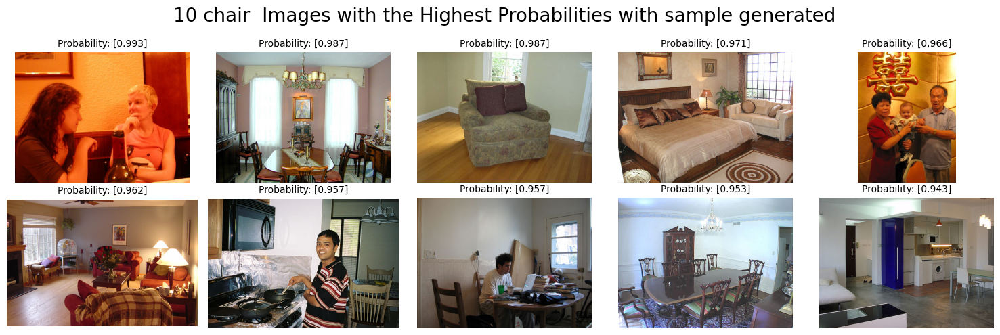

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/cow.keras
cow
70/70 [==============================] - 10s 138ms/step


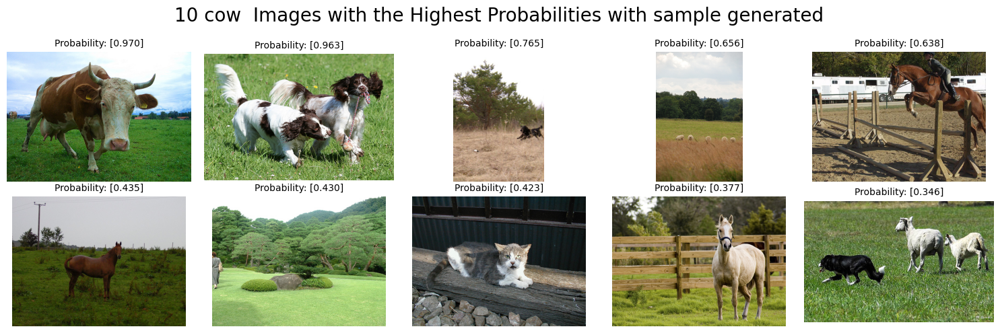

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/dog.keras
dog
70/70 [==============================] - 10s 140ms/step


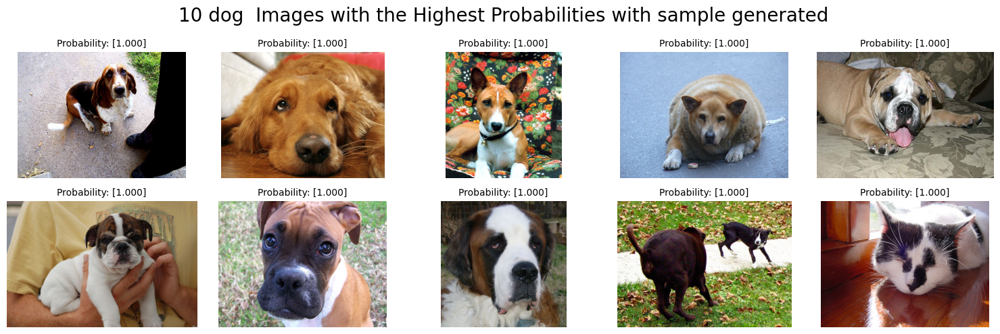

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/horse.keras
horse
70/70 [==============================] - 10s 140ms/step


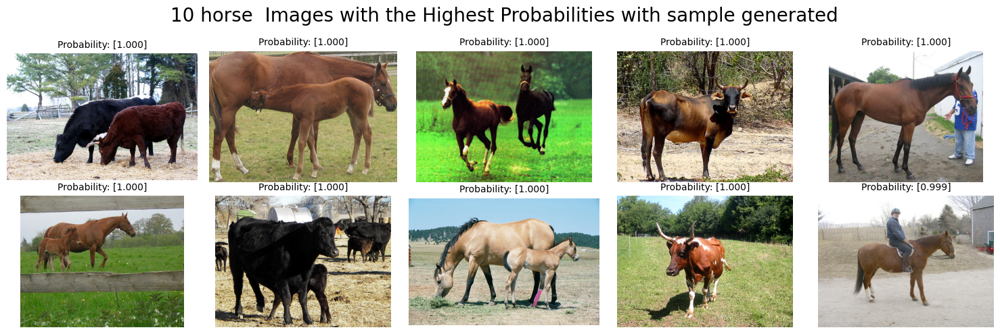

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/motorbike.keras
motorbike
70/70 [==============================] - 10s 134ms/step


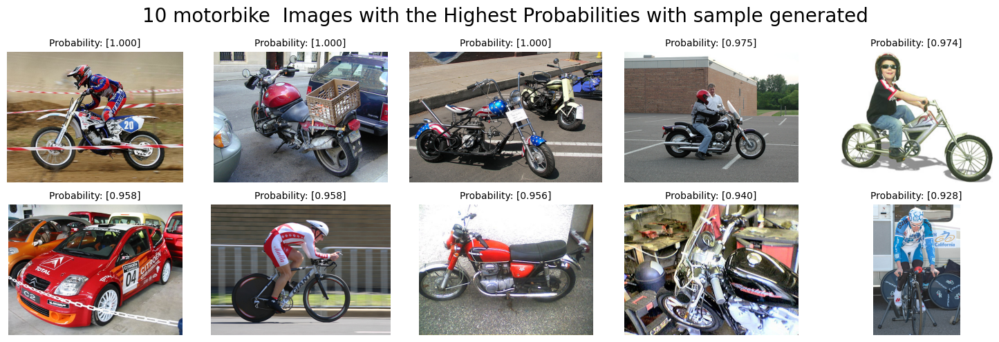

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/person.keras
person
70/70 [==============================] - 9s 129ms/step


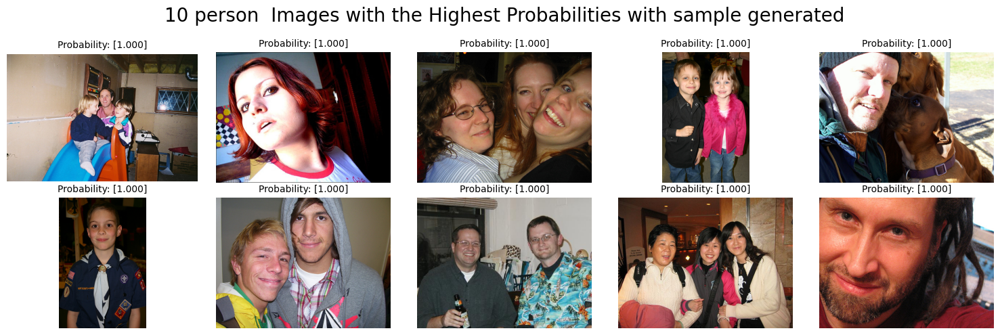

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/pottedplant.keras
pottedplant
70/70 [==============================] - 11s 147ms/step


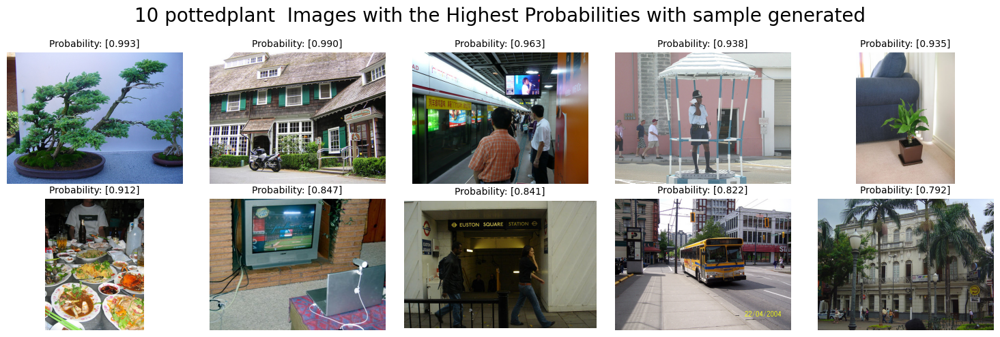

Found 2611 validated image filenames.
Found 2221 validated image filenames.
loaded /content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models/sheep.keras
sheep
70/70 [==============================] - 9s 132ms/step


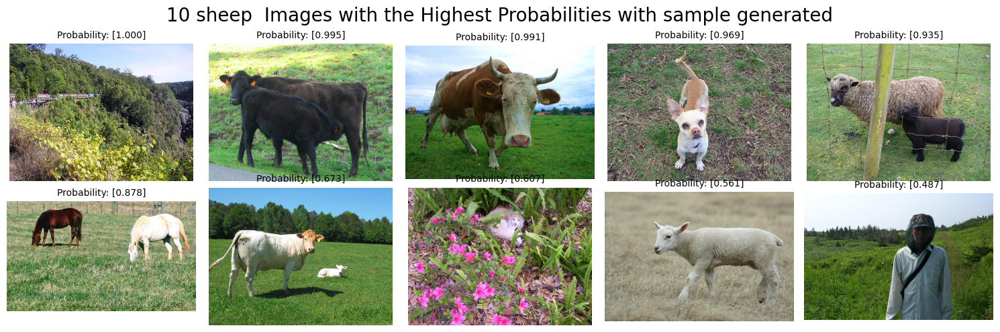

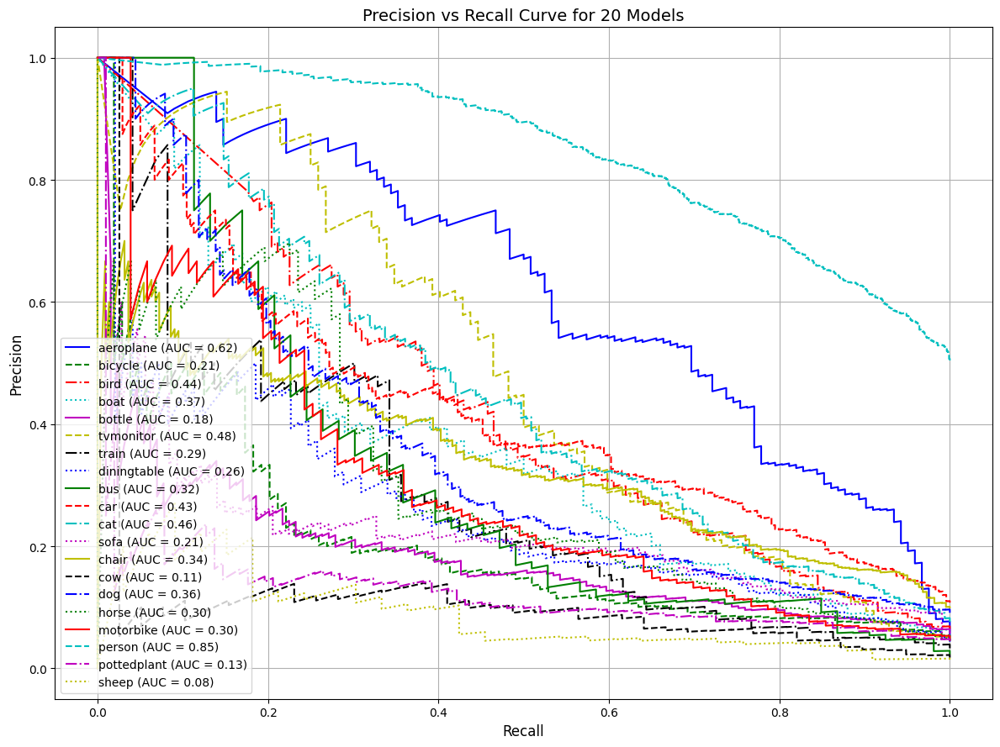

mAP: 0.34


In [63]:

MODELS_DIR = '/content/drive/MyDrive/GenAI_Project_A/VGG_GEN_AI_models'

map_values={}
THRESHOLD = 0.65
metrics = []
for _label in os.listdir(MODELS_DIR):
    if _label.endswith(f'.keras'):
      label = _label.removesuffix(f'.keras')
      _, val_gen = create_data_generators(df, label)
      model = BinaryModel(f'{label}', folder_path=MODELS_DIR)
      print(label)
      y_pred = model.predict(val_gen)

      np.set_printoptions(formatter={'float': lambda x: "{:.3f}".format(x)})


      top_indices = np.argsort(y_pred, axis=0)[-10:][::-1]
      top_indices = [inner_list[0] for inner_list in top_indices]


      filenames = val_gen.filenames


      num_rows = (len(top_indices) + 4) // 5
      fig, axs = plt.subplots(num_rows, 5, figsize=(15, 5))
      fig.suptitle(f"10 {label}  Images with the Highest Probabilities with sample generated", fontsize=20)

      for i, idx in enumerate(top_indices):

          image_id = filenames[idx]
          img = Image.open(os.path.join(IMAGES_DIR, image_id))


          predicted_probability = y_pred[idx]

          row = i // 5
          col = i % 5
          axs[row, col].imshow(img)
          axs[row, col].set_title(f'Probability: {predicted_probability}',fontsize=10)
          axs[row, col].axis('off')


      for i in range(len(top_indices), num_rows*5):
          row = i // 5
          col = i % 5
          fig.delaxes(axs[row, col])

      plt.tight_layout()
      plt.show()


      p, r, _ = precision_recall_curve(val_gen.labels, y_pred)
      _auc = auc(r, p)
      metric = {'pr' : (p, r), 'auc' : _auc, 'label' : label }
      metrics.append(metric)

plt.figure(figsize=(12, 9))
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
line_styles = ['-', '--', '-.', ':']

for i, metric in enumerate(metrics):
    p, r = metric['pr']
    area_under_curve  = metric['auc']
    label = metric['label']
    color = colors[i % len(colors)]
    line_style = line_styles[i % len(line_styles)]
    plt.plot(r, p, label=f'{label} (AUC = {area_under_curve :.2f})', color=color, linestyle=line_style)

plt.xlabel('Recall', fontsize=12)
plt.ylabel('Precision', fontsize=12)
plt.title('Precision vs Recall Curve for 20 Models', fontsize=14)
plt.legend(loc='lower left', fontsize=10)
plt.grid(True)
plt.tight_layout()
plt.show()


print("mAP: {:.2f}".format(np.mean([item['auc'] for item in metrics])))